<a href="https://colab.research.google.com/github/tackulus/204383/blob/main/Code07.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **07 1st Filtering**

> **204383 Image Processing** 

---

> **Tocktack | Kasidis Torcharoen (610510531)** \\
**Top | Kittisak Thammawong (610510611)**

**https://medium.com/@aybukeyalcinerr/correlation-vs-convolution-filtering-2711d8bb3666**

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import cv2 as cv
from google.colab.patches import cv2_imshow

In [9]:
#@title
def salt_pepper(image, s_ratio=0.5, sp_ratio=0.30):

    if image.ndim == 2: 
        image = np.expand_dims(image, axis=2)
    row, col, ch = image.shape
    noisy = np.copy(image)

    for c in range(ch):
        for i in range(row):
            for j in range(col):
                rnd = np.random.random()
                if rnd > sp_ratio: pass
                elif rnd < sp_ratio * s_ratio: 
                    noisy[i,j,c] = 255
                else:
                    noisy[i,j,c] = 0
    
    return noisy.astype("uint8")

In [91]:
image = cv.imread('0302.jpg')
noisy = salt_pepper(image)

# Correlation linear filter : Edge detection

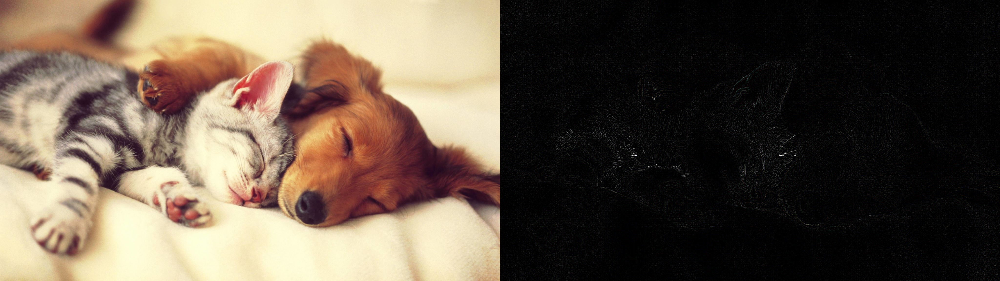

In [93]:
def EdgeDetection(image):
    kernel = np.array([[-1, -1, -1],
                       [-1,  8, -1],
                       [-1, -1, -1]])
    
    return cv.filter2D(image, -1, kernel)

result = EdgeDetection(image)
frame = np.concatenate((image, result), axis=1)
cv2_imshow(frame)

# Correlation linear filter : Box blur

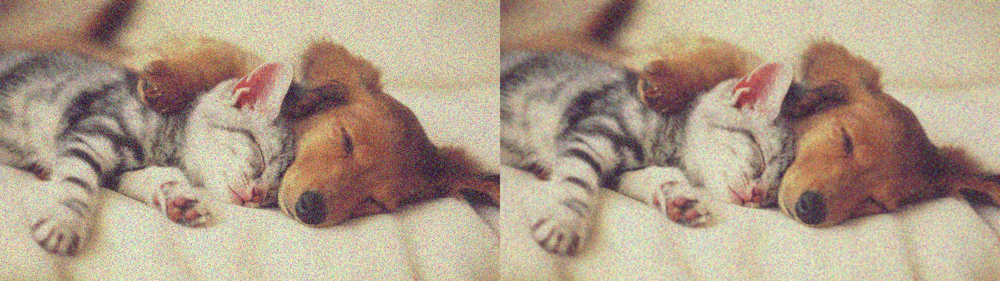

In [95]:
def BoxBlur(image, m=3):
    kernel = (1/np.square(m)) * np.ones((m, m))
    return cv.filter2D(image, -1, kernel)

result = BoxBlur(noisy, 5)
frame = np.concatenate((noisy, result), axis=1)
cv2_imshow(frame)

# Correlation non-linear filter : Median blur

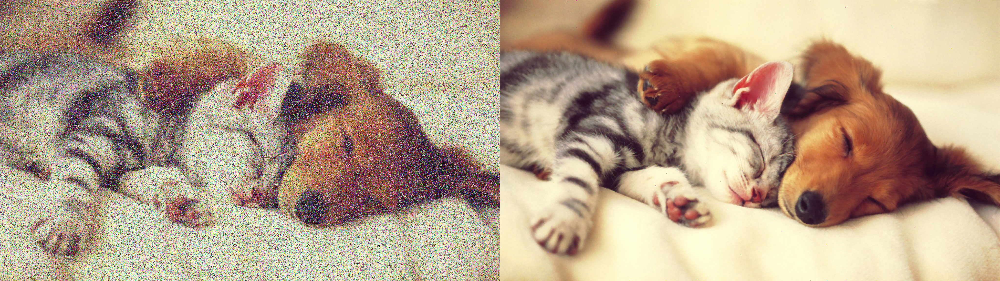

In [87]:
def MedianBlur(image, m=3):
    r_pad = np.zeros((image.shape[0], m-1, 3))
    Padded = np.concatenate((r_pad, image, r_pad), axis=1)
    c_pad = np.zeros((m-1, Padded.shape[1], 3))
    Padded = np.concatenate((c_pad, Padded, c_pad), axis=0)

    result = np.zeros_like(image)
    for i in range(image.shape[0]):
        for j in range(image.shape[1]): 
            for c in range(image.shape[2]):
                kernel = Padded[i:i+m, j:j+m, c]
                result[i,j,c] = np.median(kernel)

    return result

# Too long! So, use build-in function instead
# result = MedianBlur(noisy, 5)
result = cv.medianBlur(noisy, 5)
frame = np.concatenate((noisy, result), axis=1)
cv2_imshow(frame)


In [94]:
# prepare the filter
kernel = np.array([[0,0,1],[0,1,0],[1,0,0]])

# apply kernel to the original image using convolution filtering
dst_conv  = ndimage.convolve(image, kernel, mode='constant', cval=1.0)

# apply kernel to the original image using correlation filtering
dst_corr = cv.filter2D(image, -1, kernel)

# concatenate images horizontally
result = np.concatenate((image, dst_corr, dst_conv), axis=1)
cv2_imshow(result)


RuntimeError: ignored

**https://opencv24-python-tutorials.readthedocs.io/en/latest/py_tutorials/py_imgproc/py_filtering/py_filtering.html**

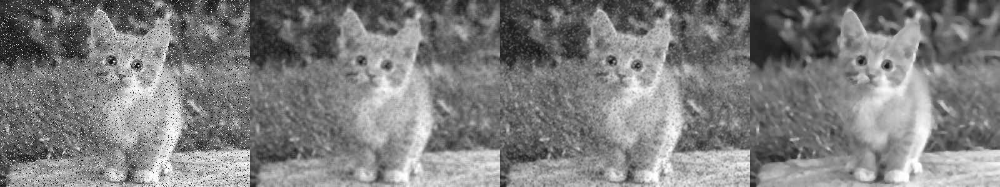

In [ ]:
#Linear
#Blurr
blur = cv2.blur(image,(5,5))
Gblur = cv2.GaussianBlur(image,(5,5),0)
median = cv2.medianBlur(image,5)

frame = cv2.hconcat((image, blur, Gblur, median))
cv2_imshow(frame)

**https://www.youtube.com/watch?v=lJXCzhJI6hU**

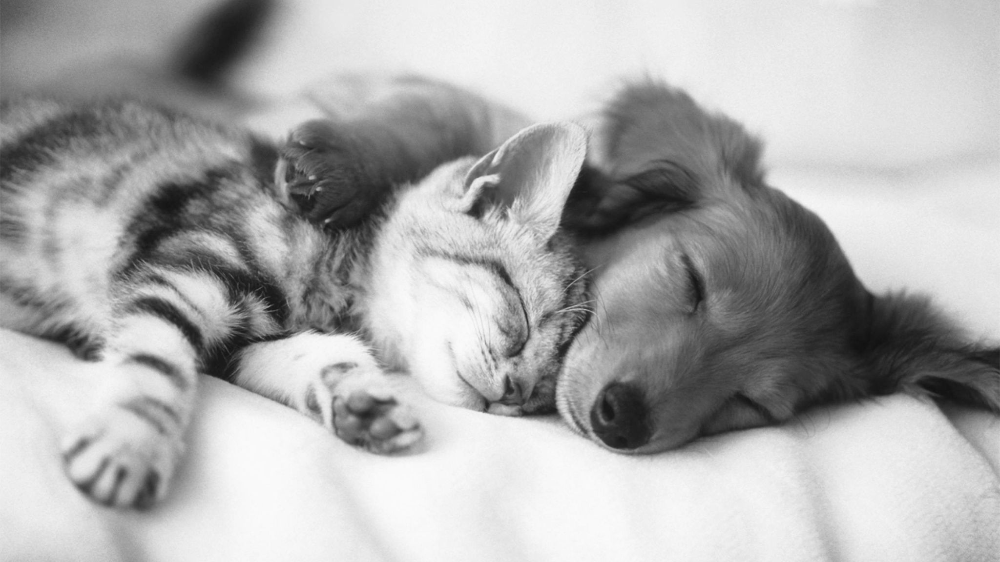

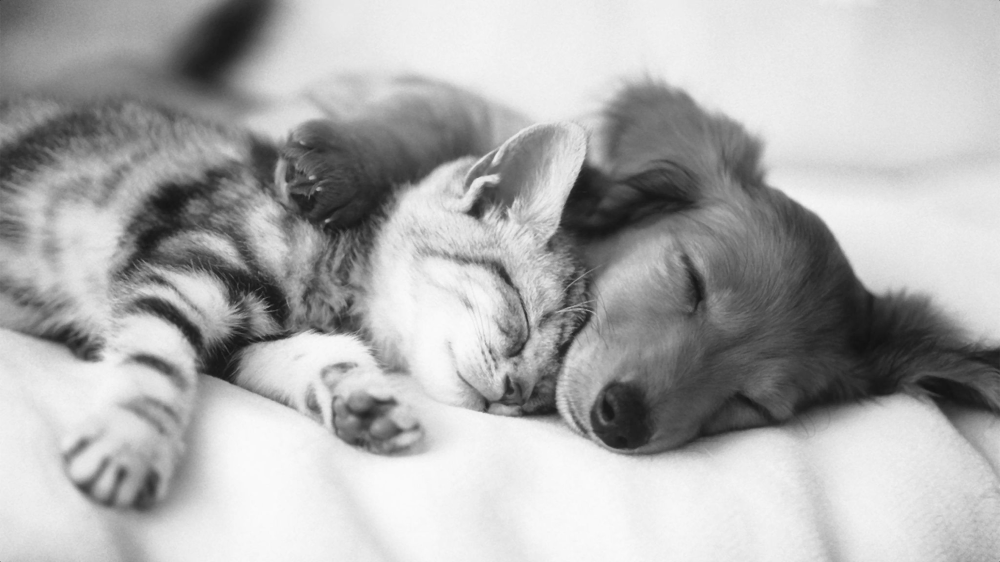

In [84]:
#Convolution and Correlation (Median filter)
#filter (3,3)
filt = np.array([(1,1,1), (1,1,1), (1,1,1)])*(1/9) 

S = image.shape
F = filt.shape

#binary conversion
catGray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
cv2_imshow(catGray)

R = S[0] + F[0] - 1
C = S[1] + F[1] - 1
Z = np.zeros((R,C))

for i in range(S[0]):
    for j in range(S[1]):
        Z[i+np.int((F[0]-1)/2), j+np.int((F[1]-1)/2)] = catGray[i,j]

for i in range(S[0]):
    for j in range(S[1]):
        k = Z[i:i+F[0],j:j+F[1]]
        l = np.median(k)
        catGray[i,j] = l

cv2_imshow(catGray)

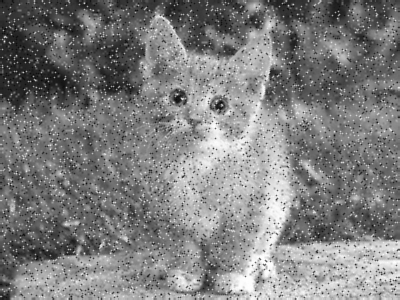

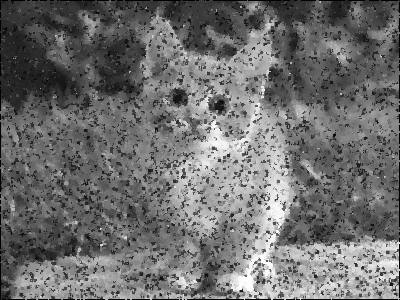

In [ ]:
#Convolution and Correlation (Mode filter)
#filter (3,3)
filt = np.array([(1,1,1), (1,1,1), (1,1,1)])*(1/9) 

S = cat.shape
F = filt.shape

#binary conversion
catGray = cv2.cvtColor(cat,cv2.COLOR_BAYER_BG2GRAY) 
cv2_imshow(catGray)

R = S[0] + F[0] - 1
C = S[1] + F[1] - 1
Z = np.zeros((R,C))

for i in range(S[0]):
    for j in range(S[1]):
        Z[i+np.int((F[0]-1)/2), j+np.int((F[1]-1)/2)] = catGray[i,j]

for i in range(S[0]):
    for j in range(S[1]):
        k = Z[i:i+F[0],j:j+F[1]]
        l = stats.mode(k,axis=None)
        catGray[i,j] = l[0][0]

cv2_imshow(catGray)